$\Large\color{blue}{\text{PyGMTSAR Sentinel-1 SLC Timeseries Analysis 2 Scenes 6 Subswaths 15m}}$

$\Large\color{blue}{\text{This notebook is optimized to work in Docker container (Ubuntu 22.04 Jammy) 16 GB RAM 1 GB swap 4 cores}}$

### PyGMTSAR is my free-time Open Source project.

That's a bit curious how the project was started a year ago. I develop geophysical inversion methods and processing software for many years using my fundamental physics and mathematics background. Satellite interferometry is the key point to validate my inversion models and I found the same problem as you too that the existing interferometry packages usage is a pain. There is no interactive processing with multiprocessing and even a progressbar and ability to view and change every step code and validate the results. Also, many used algorithms are too outdated and produce terrible results like to tension surfaces in GMT which is used widely in GMTSAR (hmm, how about to control a smothness of derivative? Tension surfaces were invented when all the Earths computers where less powerfull than your smarthone today. If you are interested I shared the examples in GMTSAR bug tracker). Anyway, I found GMT mathematics is really crazy and the developers replace one incorrect algorithm by another and back often as we see in the codes and the changelog). That was enough reason to check all the used algorithms and replace these by modern and correct ones. By this way, I use only GMTSAR C codes with my patches to fix some errors and allow interoperability with Python wrappers plus my own codes around them. GMTSAR codes are fine and without crazy GMT codes work better and the processing is much faster. Alright, I spent one month to make the initial PyGMTSAR realization and it works. Recently, I returned to the project to add some more sophisticated features like to scenes and subswathes stitching. I'm going to share some of my geological exprorations and seismic models as live examples on Google Colab as soon as it will be possible to do. How lineaments and ore zones are related to interferograms? How gas and oil deposits are related to surface movements on interferometry displacement maps? I have the answer and I work on the tools to model and visualize them.

You'd find my theoretical models and processing codes foir geophisical inversions in Github repository https://github.com/mobigroup/gis-snippets and tools for the 4D results vizualization in https://github.com/mobigroup/ParaView-plugins

Ah yes, a little bit about me. I have STEM master's degree in radio physics and in 2004 I was awarded first prize of the All-Russian Physics competition for significant results in Inverse modeling for non-linear optics and holography, also applicable for Inverse Modeling of Gravity, Magnetic, and Thermal fields. In addition to my fundamental science knowledge, I’m world class data scientist and software developer with 20 years experience in science and industrial development. I have worked on government contracts and universities projects and on projects for LG Corp, Google Inc, etc. You are able to find some of my software and results on LinkedIn and GitHub and Upwork. By the way, I left Russia many years ago and I work remotely for about 20 years.

### To order some research, development and support see my profile on freelance platform [Upwork](https://www.upwork.com/freelancers/~01e65e8e7221758623)

### @ Alexey Pechnikov, August, 2022

[Geological models on YouTube channel](https://www.youtube.com/channel/UCSEeXKAn9f_bDiTjT6l87Lg)

[Augmented Reality (AR) Geological Models](https://mobigroup.github.io/ParaView-Blender-AR/)

[GitHub repositories](https://github.com/mobigroup)

[English posts and articles on LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/)

[Russian articles on Habr](https://habr.com/ru/users/N-Cube/posts/)

## Load Modules to Check Environment

In [1]:
import platform, sys, os

## Load and Setup Python Modules

In [2]:
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
import shapely
import json
import scipy.signal
# supress numpy warnings
import warnings
warnings.filterwarnings('ignore')

In [3]:
# plotting modules
import hvplot.pandas  # noqa
import hvplot.xarray  # noqa
import holoviews as hv
pd.options.plotting.backend = 'hvplot'
from IPython.display import Image
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [4]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

## Load Custom Python Modules

In [5]:
# default chunksize (512) is enough suitable for a single subswath processing using resolution 15m
# select higher chunk size (1024) to process multiple subswaths and scenes using resolution 15m
from pygmtsar import datagrid
datagrid.chunksize = 1024

In [6]:
# import the top level class only
from pygmtsar import SBAS

## Define Processing Parameters

In [7]:
ORBIT     = 'D'
SUBSWATH  = 123
# common configuration
DATADIR      = 'data_asc' if ORBIT == 'A' else 'data_desc'
#BACKUP       = 'backup_asc' if ORBIT == 'A' else 'backup_desc'
BACKUP       = None
WORKDIR      = 'raw_asc' if ORBIT == 'A' else 'raw_desc'
DEMFILE      = None
POLARIZATION = 'VV'
# SBAS parameters
BASEDAYS     = 65
BASEMETERS   = 150
RESOLUTION   = 15

In [8]:
# minimal mean stack correlation to define AOI valid pixels
TARGETCORRLIMIT = 0.5
# exclude low-coherence areas like to water surfaces
CORRLIMIT = 0.15

In [9]:
# define helper function
#def detrend(pair):
#    return sbas.detrend(pair, wavelength=20000, fit_intercept=True, fit_dem=True, fit_coords=True, debug=False)

## Run Local Dask Cluster

For multicore processing of the all big rasters launch Dask cluster

In [10]:
import dask, dask.distributed
# increase timeouts to work using default chunk size (512) even on large areas
dask.config.set({'distributed.comm.timeouts.tcp': '60s'})
#print (dask.config.get("distributed.comm.timeouts.tcp"))
dask.config.set({'distributed.comm.timeouts.connect': '60s'})
#print (dask.config.get("distributed.comm.timeouts.connect"))

from dask.distributed import Client, LocalCluster
cluster = LocalCluster(n_workers=1)
client = Client(cluster)
client

2022-11-19 09:47:24,909 - distributed.diskutils - INFO - Found stale lock file and directory '/tmp/dask-worker-space/worker-69i8gx8c', purging


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 1
Total threads: 4,Total memory: 15.61 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:35833,Workers: 1
Dashboard: http://127.0.0.1:8787/status,Total threads: 4
Started: Just now,Total memory: 15.61 GiB
Comm: tcp://127.0.0.1:37809,Total threads: 4
Dashboard: http://127.0.0.1:41299/status,Memory: 15.61 GiB
Nanny: tcp://127.0.0.1:39435,


## Restore SBAS

In [11]:
sbas = SBAS.restore(WORKDIR)

NOTE: load state from file raw_desc/SBAS.pickle


In [12]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-02-02,2022-02-02 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220202t025256-20220202t025346-041728-04f723-004.tiff, raw_desc/s1a-iw2-slc-vv-20220202t025254-20220202t025346-041728-04f723-005.tiff, raw_desc/s1a-iw3-slc-vv-20220202t025255-20220202t025345-041728-04f723-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220202t025256-20220202t025346-041728-04f723-004.xml, raw_desc/s1a-iw2-slc-vv-20220202t025254-20220202t025346-041728-04f723-005.xml, raw_desc/s1a-iw3-slc-vv-20220202t025255-20220202t025345-041728-04f723-006.xml]",data_desc/S1A_OPER_AUX_POEORB_OPOD_20220222T081603_V20220201T225942_20220203T005942.EOF,"POLYGON ((49.54992 39.58491, 48.78032 36.48917, 47.86182 36.71751, 47.82594 36.56841, 46.77495 36.82136, 46.78495 36.86293, 45.97585 37.03591, 46.63417 40.11510, 47.52200 39.92529, 47.56072 40.08617, 48.61171 39.83322, 48.60829 39.81900, 49.54992 39.58491))"
2022-02-14,2022-02-14 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220214t025256-20220214t025346-041903-04fd3e-004.tiff, raw_desc/s1a-iw2-slc-vv-20220214t025254-20220214t025347-041903-04fd3e-005.tiff, raw_desc/s1a-iw3-slc-vv-20220214t025255-20220214t025345-041903-04fd3e-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220214t025256-20220214t025346-041903-04fd3e-004.xml, raw_desc/s1a-iw2-slc-vv-20220214t025254-20220214t025347-041903-04fd3e-005.xml, raw_desc/s1a-iw3-slc-vv-20220214t025255-20220214t025345-041903-04fd3e-006.xml]",data_desc/S1A_OPER_AUX_POEORB_OPOD_20220306T081614_V20220213T225942_20220215T005942.EOF,"POLYGON ((49.54920 39.58515, 48.77939 36.48867, 47.86097 36.71699, 47.82509 36.56790, 46.77415 36.82084, 46.78415 36.86241, 45.97506 37.03540, 46.63355 40.11510, 47.52134 39.92528, 47.56006 40.08615, 48.61100 39.83321, 48.60763 39.81923, 49.54920 39.58515))"
2022-02-26,2022-02-26 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220226t025256-20220226t025345-042078-050346-004.tiff, raw_desc/s1a-iw2-slc-vv-20220226t025254-20220226t025346-042078-050346-005.tiff, raw_desc/s1a-iw3-slc-vv-20220226t025255-20220226t025345-042078-050346-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220226t025256-20220226t025345-042078-050346-004.xml, raw_desc/s1a-iw2-slc-vv-20220226t025254-20220226t025346-042078-050346-005.xml, raw_desc/s1a-iw3-slc-vv-20220226t025255-20220226t025345-042078-050346-006.xml]",data_desc/S1A_OPER_AUX_POEORB_OPOD_20220318T081639_V20220225T225942_20220227T005942.EOF,"POLYGON ((49.54952 39.58515, 48.77973 36.48891, 47.86132 36.71725, 47.82552 36.56852, 46.77459 36.82148, 46.78456 36.86291, 45.97546 37.03592, 46.63395 40.11538, 47.52174 39.92554, 47.56046 40.08642, 48.61139 39.83346, 48.60796 39.81923, 49.54952 39.58515))"


## Find SBAS Pairs

Scan work directory to find all the processed pairs

In [13]:
pairs = sbas.find_pairs('corr')
pairs

array([['20220202', '20220214'],
       ['20220202', '20220226'],
       ['20220214', '20220226']], dtype='<U8')

## Build decimator for plots

Large grid plots require a lot of RAM so decimate plots to build smaller images visually almost the same as the original ones.

In [14]:
# decimate arrays to plot
decimator = sbas.pixel_decimator(resolution_meters=600, debug=True)

DEBUG: average per subswaths ground pixel size in meters: y=14.0, x=14.6
DEBUG: decimator = lambda da: da.coarsen({'y': 43, 'x': 41}, boundary='trim').mean()


### Load Data

In [15]:
# unwrapped grid may be cropped so crop correlation grid too
corrs = sbas.open_grids(pairs, 'corr')
corrs

Loading:   0%|          | 0/3 [00:00<?, ?it/s]

,Array,Chunk
Bytes,4.87 GiB,4.00 MiB
Shape,"(3, 25613, 17029)","(1, 1024, 1024)"
Count,10 Graph Layers,1326 Chunks
Type,float32,numpy.ndarray


In [16]:
# unwrapped grid may be cropped so crop correlation grid too
unwraps = sbas.open_grids(pairs, 'unwrap')
unwraps

Loading:   0%|          | 0/3 [00:00<?, ?it/s]

,Array,Chunk
Bytes,4.84 GiB,4.00 MiB
Shape,"(3, 25612, 16908)","(1, 1024, 1024)"
Count,10 Graph Layers,1326 Chunks
Type,float32,numpy.ndarray


## Detrend Single Phase

Define the detrending parameters. Be careful with too small AOI and wavelength to prevent overfitting.

In [17]:
def plot_sample(idx, wavelength, fit_intercept=True, fit_dem=True, fit_coords=True):
    pair = pairs[idx:idx+1]
    da = sbas.open_grids(pair, 'unwrap')[0]
    # crop correlation grid like to unwrap grid if needed
    corr = sbas.open_grids(pair, 'corr')[0].reindex_like(da)
    label = da.pair.item()
    da_detrend = sbas.detrend_parallel([pair.values[0] if isinstance(pairs, pd.DataFrame) else pair[0]],
                              wavelength=wavelength,
                              fit_intercept=fit_intercept, fit_dem=fit_dem, fit_coords=fit_coords,
                              interactive=True)[0]

    fig = plt.figure(figsize=(16,4), dpi=300)

    ax = fig.add_subplot(1, 4, 1)
    decimator(corr).plot.imshow(cmap='gray', vmin=0, vmax=1, ax=ax)
    ax.set_title('Correlation', fontsize=18)

    #zmin, zmax = np.nanquantile(da, [0.001, 0.999])
    ax = fig.add_subplot(1, 4, 2)
    decimator(da).plot.imshow(cmap='turbo', ax=ax)
    ax.set_title('Phase, [rad]', fontsize=18)

    #zmin, zmax = np.nanquantile((da - da_detrend), [0.001, 0.999])
    ax = fig.add_subplot(1, 4, 3)
    decimator(da - da_detrend).plot.imshow(cmap='turbo', ax=ax)
    ax.set_title('Trend, [rad]', fontsize=18)

    #zmin, zmax = np.nanquantile(da_detrend, [0.001, 0.999])
    ax = fig.add_subplot(1, 4, 4)
    decimator(da_detrend).plot.imshow(cmap='turbo', ax=ax)
    ax.set_title('Detrended, [rad]', fontsize=18)

    plt.suptitle(f'AOI Unwrapped Phase {label.replace(" "," to ")}', fontsize=18)
    plt.tight_layout()
    plt.show()

### Example 1

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Detrending:   0%|          | 0/1 [00:00<?, ?it/s]

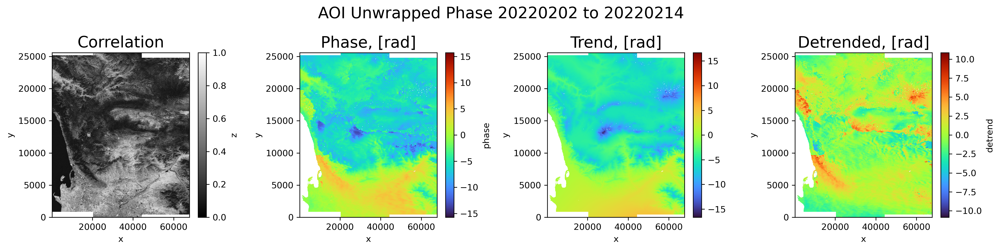

CPU times: user 44.5 s, sys: 2.79 s, total: 47.2 s
Wall time: 3min 10s


In [18]:
%%time
plot_sample(0, None)

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Detrending:   0%|          | 0/1 [00:00<?, ?it/s]

NOTE: Gaussian filter cut-off wavelength is not defined, function does nothing


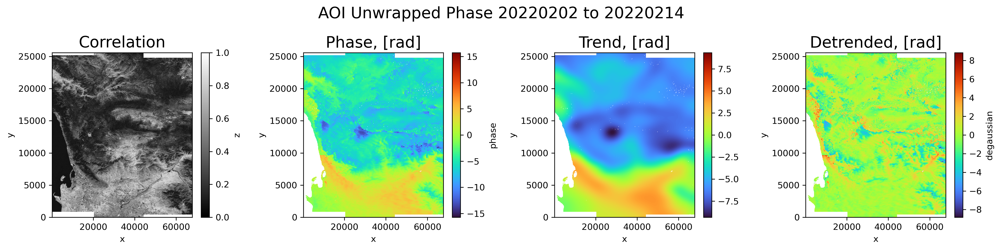

CPU times: user 32.9 s, sys: 1.66 s, total: 34.6 s
Wall time: 2min 48s


In [19]:
%%time
plot_sample(0, 10000, fit_intercept=False, fit_dem=False, fit_coords=False)

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Detrending:   0%|          | 0/1 [00:00<?, ?it/s]

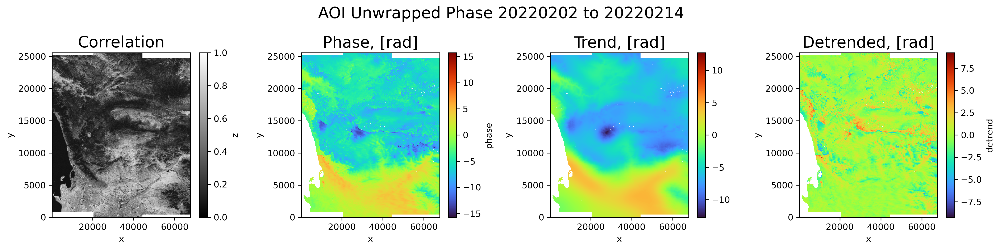

CPU times: user 1min 5s, sys: 3.73 s, total: 1min 9s
Wall time: 5min 40s


In [20]:
%%time
plot_sample(0, 10000)

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Detrending:   0%|          | 0/1 [00:00<?, ?it/s]

NOTE: All the detrending options disable, function does nothing


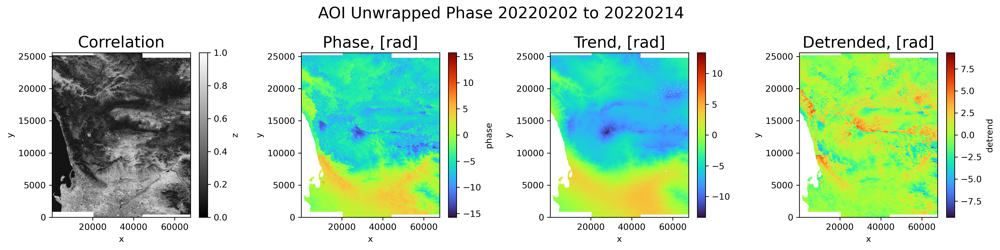

CPU times: user 1min 5s, sys: 4.06 s, total: 1min 9s
Wall time: 6min 44s


In [21]:
%%time
plot_sample(0, 20000)

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Detrending:   0%|          | 0/1 [00:00<?, ?it/s]

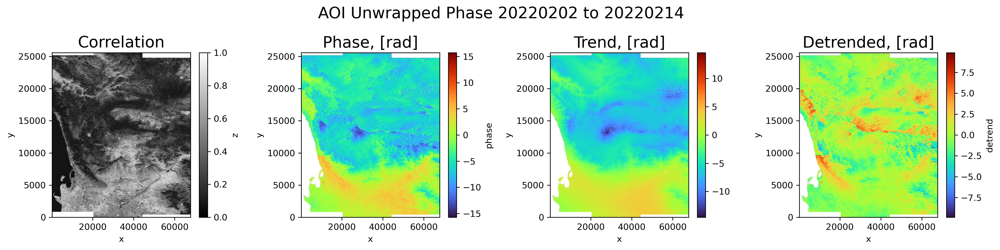

CPU times: user 1min 10s, sys: 4.88 s, total: 1min 15s
Wall time: 8min 3s


In [22]:
%%time
plot_sample(0, 30000)

## Detrend All

Use the parameters checked above to process all the grids and save all the results

In [23]:
sbas.detrend_parallel(pairs, wavelength=20000, n_jobs=1)

Detrending and Saving:   0%|          | 0/3 [00:00<?, ?it/s]

### Display Unwrapped Phase, Trend and Detrended Phase

In [24]:
unwraps = sbas.open_grids(pairs, 'unwrap')
unwraps

Loading:   0%|          | 0/3 [00:00<?, ?it/s]

,Array,Chunk
Bytes,4.84 GiB,4.00 MiB
Shape,"(3, 25612, 16908)","(1, 1024, 1024)"
Count,10 Graph Layers,1326 Chunks
Type,float32,numpy.ndarray


In [25]:
unwraps_detrend = sbas.open_grids(pairs, 'detrend')
unwraps_detrend

Loading:   0%|          | 0/3 [00:00<?, ?it/s]

,Array,Chunk
Bytes,4.84 GiB,4.00 MiB
Shape,"(3, 25612, 16908)","(1, 1024, 1024)"
Count,10 Graph Layers,1326 Chunks
Type,float32,numpy.ndarray


In [26]:
unwraps_trend = unwraps - unwraps_detrend
unwraps_trend

,Array,Chunk
Bytes,4.84 GiB,4.00 MiB
Shape,"(3, 25612, 16908)","(1, 1024, 1024)"
Count,21 Graph Layers,1326 Chunks
Type,float32,numpy.ndarray


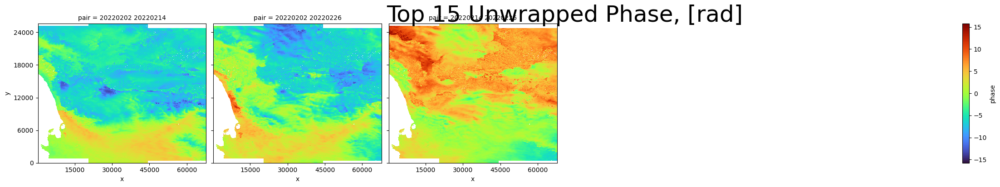

In [27]:
# decimate to plot faster
fg = decimator(unwraps[:15]).plot.imshow(
    col='pair',
    col_wrap=5, size=4, aspect=1.2,
    cmap='turbo'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Top 15 Unwrapped Phase, [rad]', y=1.02, fontsize=36)
#plt.savefig(f'Unwrapped Phase, [rad].jpg', dpi=150, quality=95)
plt.show()

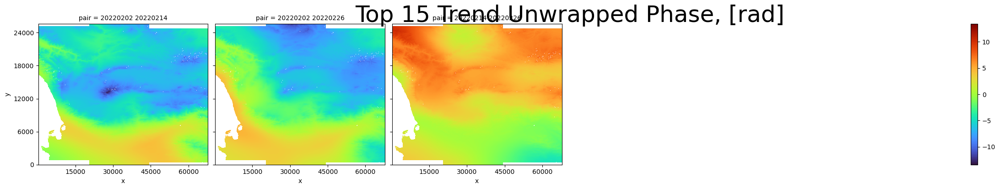

In [28]:
# decimate to plot faster
fg = decimator(unwraps_trend[:15]).plot.imshow(
    col='pair',
    col_wrap=5, size=4, aspect=1.2,
    cmap='turbo'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Top 15 Trend Unwrapped Phase, [rad]', y=1.02, fontsize=36)
#plt.savefig(f'Unwrapped Phase, [rad].jpg', dpi=150, quality=95)
plt.show()

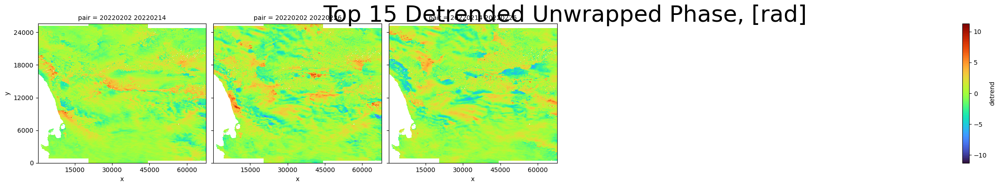

In [29]:
# decimate to plot faster
fg = decimator(unwraps_detrend[:15]).plot.imshow(
    col='pair',
    col_wrap=5, size=4, aspect=1.2,
    cmap='turbo'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Top 15 Detrended Unwrapped Phase, [rad]', y=1.02, fontsize=36)
#plt.savefig(f'Unwrapped Phase, [rad].jpg', dpi=150, quality=95)
plt.show()

## Check Interferograms

In [30]:
unwraps_detrend_std = unwraps_detrend.std(['y','x']).compute()

In [31]:
unwraps_detrend_std_median = unwraps_detrend_std.rolling(pair=5, center=True)\
    .median()

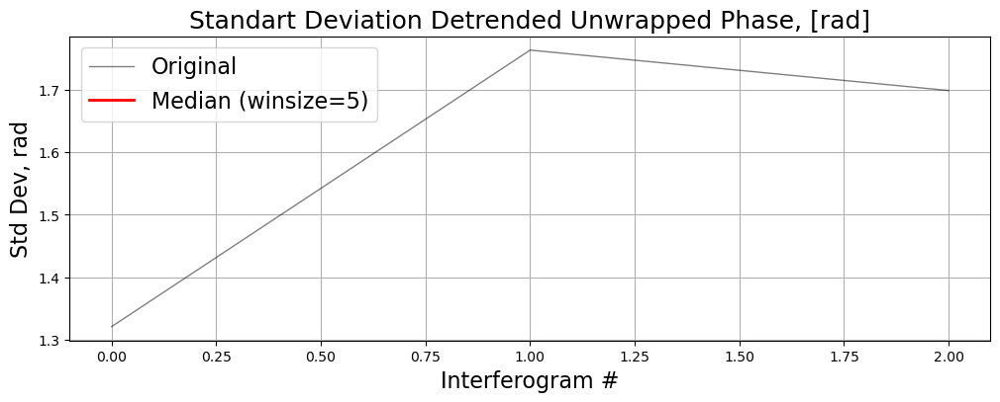

In [32]:
indices = pd.to_datetime(unwraps_detrend_std.ref, format='%Y%m%d').date
indices = range(len(indices))

plt.figure(figsize=(12,4))
#plt.plot(indices, unwraps_detrend_std, 'bo')
plt.plot(indices, unwraps_detrend_std, 'black', alpha=0.5, lw=1, label='Original')
plt.plot(indices, unwraps_detrend_std_median, 'r', lw=2, label='Median (winsize=5)')
#plt.xlim([indices[0].item(), indices[-1].item()])
plt.xlabel('Interferogram #', fontsize=16)
plt.ylabel('Std Dev, rad', fontsize=16)
plt.title('Standart Deviation Detrended Unwrapped Phase, [rad]', fontsize=18)
plt.grid()
plt.legend(fontsize=16)
plt.show()

## SBAS Analysis

SBAS processing creates displacement maps (rad) for every date

In [33]:
# process the full unwrap grid (correlation grid will be cropped if needed)
sbas.sbas_parallel(pairs)

Loading:   0%|          | 0/3 [00:00<?, ?it/s]

Loading:   0%|          | 0/3 [00:00<?, ?it/s]

Computing:   0%|          | 0/858 [00:00<?, ?it/s]

Saving:   0%|          | 0/3 [00:00<?, ?it/s]

## Load SBAS Results and Calculate LOS Displacement

In [34]:
sbas_disps = sbas.open_grids(sbas.find_dates(), 'disp', func=[sbas.los_displacement_mm])
sbas_disps

Loading:   0%|          | 0/3 [00:00<?, ?it/s]

,Array,Chunk
Bytes,4.84 GiB,4.00 MiB
Shape,"(3, 25612, 16908)","(1, 1024, 1024)"
Count,13 Graph Layers,1326 Chunks
Type,float32,numpy.ndarray


In [35]:
# filter outliers
# for 2k x 3k 30m single-subswath grid 1e-5 threshould means 60 pixels only
qas = sbas_disps.chunk(dict(x=-1,y=-1)).quantile([1e-4, 1-1e-4], dim=('y','x'))
sbas_disps = sbas_disps.where((sbas_disps>=qas[0])&(sbas_disps<=qas[1]))
sbas_disps

,Array,Chunk
Bytes,4.84 GiB,4.00 MiB
Shape,"(3, 25612, 16908)","(1, 1024, 1024)"
Count,28 Graph Layers,1326 Chunks
Type,float32,numpy.ndarray


In [36]:
%%time

sbas_disps_min = sbas_disps.min(dim=('y','x')).compute()
sbas_disps_max = sbas_disps.max(dim=('y','x')).compute()

/opt/conda/lib/python3.10/site-packages/dask/array/reductions.py:611: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/opt/conda/lib/python3.10/site-packages/dask/array/reductions.py:640: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


CPU times: user 20.7 s, sys: 1.79 s, total: 22.5 s
Wall time: 2min 59s


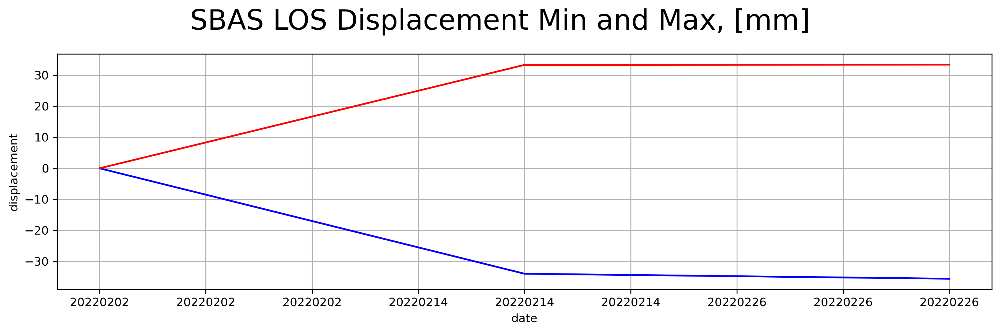

CPU times: user 686 ms, sys: 54.5 ms, total: 740 ms
Wall time: 403 ms


In [37]:
%%time

fig = plt.figure(figsize=(12,4), dpi=300)

ax = fig.add_subplot(1, 1, 1)
sbas_disps_min.plot(c='blue', ax=ax)
sbas_disps_max.plot(c='red', ax=ax)
plt.grid()
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(10))
plt.suptitle('SBAS LOS Displacement Min and Max, [mm]', fontsize=24)
plt.tight_layout()
plt.show()

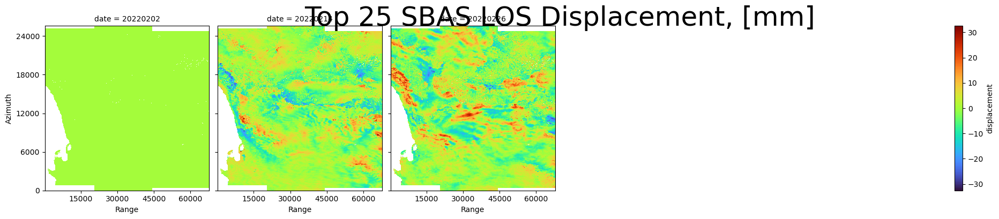

CPU times: user 23.9 s, sys: 1.58 s, total: 25.5 s
Wall time: 2min 30s


In [38]:
%%time

fg = decimator(sbas_disps[:25]).plot.imshow(
    col='date',
    col_wrap=5, size=4,
    cmap='turbo'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Top 25 SBAS LOS Displacement, [mm]', y=1.01, fontsize=36)
plt.show()

## Analyze SBAS Results

In [39]:
# materialize the results
sbas_disps_avg = sbas_disps.mean(['y','x']).compute()
sbas_disps_avg

<xarray.DataArray 'displacement' (date: 3)>
array([0.        , 0.11638214, 0.01726229], dtype=float32)
Coordinates:
  * date     (date) <U8 '20220202' '20220214' '20220226'

In [40]:
sbas_disps_avg_median = sbas_disps_avg.rolling(date=5, center=True)\
    .median()

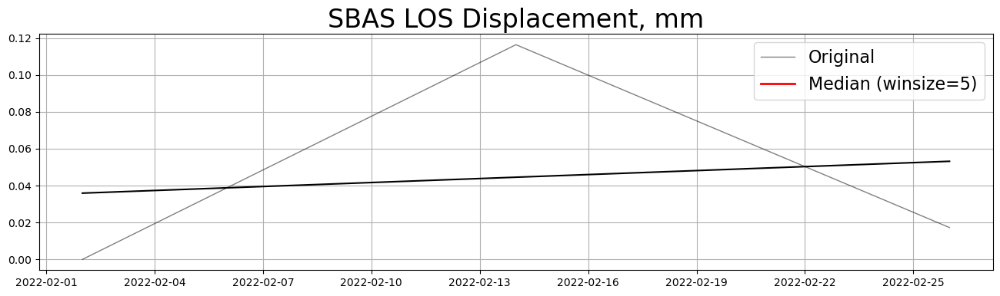

In [41]:
indices = pd.to_datetime(sbas_disps_avg.date, format='%Y%m%d').date

plt.figure(figsize=(16,4))
xs = range(len(indices))
ys = sbas_disps_avg
trend = np.polyfit(xs,ys,1)
#plt.plot(index,ys,'black', marker='o')
plt.plot(indices,ys,'black', alpha=0.5, lw=1, label='Original')
trendpoly = np.poly1d(trend) 
plt.plot(indices,trendpoly(xs),'black')
plt.plot(indices, sbas_disps_avg_median, 'red', lw=2, label='Median (winsize=5)')
plt.title('SBAS LOS Displacement, mm', fontsize=24)
plt.legend(fontsize=16)
plt.grid()
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(10))
plt.show()

## Check the Total Displacement

In [42]:
sbas_disps_total = sbas_disps.cumsum('date')[-1]
sbas_disps_total

<xarray.DataArray 'displacement' (y: 25612, x: 16908)>
dask.array<getitem, shape=(25612, 16908), dtype=float32, chunksize=(1024, 1024), chunktype=numpy.ndarray>
Coordinates:
    date     <U8 '20220226'
  * x        (x) float64 198.0 202.0 206.0 ... 6.782e+04 6.782e+04 6.783e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.561e+04 2.561e+04

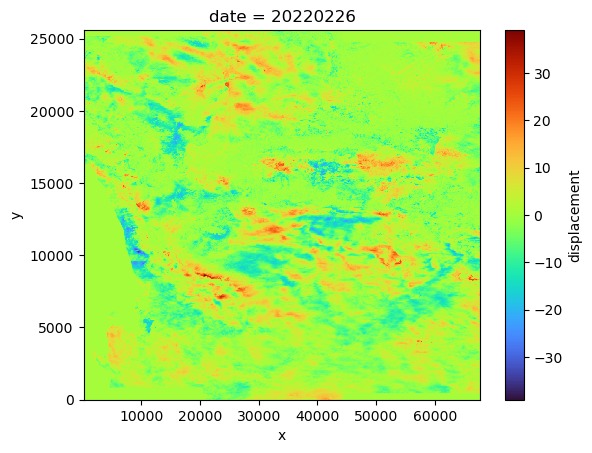

In [43]:
decimator(sbas_disps_total).plot.imshow(cmap='turbo')

## Save the Total Displacement in Geographic Coordinates

In [44]:
sbas_disps_total_ll = sbas.intf_ra2ll(sbas_disps_total)
sbas_disps_total_ll

<xarray.DataArray 'displacement' (lat: 25609, lon: 25851)>
dask.array<getitem, shape=(25609, 25851), dtype=float32, chunksize=(1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 36.53 36.53 36.53 36.53 ... 40.09 40.09 40.09 40.09
  * lon      (lon) float64 45.98 45.98 45.98 45.98 ... 49.57 49.57 49.57 49.57
    date     <U8 '20220226'

In [45]:
filename = f'{WORKDIR}.displacement.nc'
# drop the existing file first
!rm -fr {filename}
# show progress indicator for the long operation
from pygmtsar import tqdm_dask
# read all the correlation grids as 3D stack and calculate maximum value for every pixel
delayed = sbas_disps_total_ll.to_netcdf(filename, engine=sbas.engine, compute=False)
tqdm_dask(dask.persist(delayed), desc='Saving Total Displacement as NetCDF')

Saving Total Displacement as NetCDF:   0%|          | 0/9000000.0 [00:00<?, ?it/s]